# Setup

Import libraries needed to perform the analysis.

- **Random**: Gives access to the Python's random number generator module.
- **Math**: Gives access to the Python's math module.
- **Numpy**: Fundamental package for scientific computing with Python.
- **Pandas**: High-performance, easy-to-use data structures and data analysis tools for Python.
- **Matplotlib**: Python 2D data plotting library.

In [16]:
import random
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

Set figure size in plots generated by matplotlib:

In [17]:
plt.rcParams['figure.figsize'] = (30, 10)

Simulation parameters are set first, these are as follows:

- **p_winning**: Probability of winning.
- **init_capital**: Initial capital to start the simulation.
- **ruin_capital**: Capital that if reached by the simulation then it's interpreted as reaching ruin.
- **run_times**: Simulation is runs this many times.
- **trials**: Trials to run on each simulation step.
- **mdd_level**: Desired Maximum Drawdown level to accent in plots. Value should be in the range `[-1, 0]`.

Percentiles to accent in plots are also configured here.

In [18]:
p_winning = 0.52

init_capital = 10000
ruin_capital = 0
run_times = 100
trials = 1000
mdd_level = -0.30  # Desired MDD : Negative [-1, 0] : (appears as h line in CDF Maximum Drawdown)

# Control vline position on CDF graphs
percentile_avg = 0.5
percentile_below = 0.05
percentile_above = 0.95

The `play` function takes a probability value `p` and runs a random simulation that returns `True` with that given probability and `False` with `1 - p` probability. This function simulates a random outcome with a known probability.

In [19]:
def successful_trade(p=p_winning):
    roll = random.randint(1, 100)

    threshold = p * 100
    
    # User win when rolling [0, p]
    if roll <= threshold:
        return True
    
    return False

# Computing strategies
## Fixed position sizing

In this position sizing method the player always bet the same amount.

In [20]:
def fixed_strategy(funds, pos_size, trials):
    current_funds = funds
    
    trades = np.array([], dtype=int)
    funds = np.array([], dtype=int)
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            if successful_trade():
                current_funds += pos_size
            else:
                current_funds -= pos_size
                
        trades = np.append(trades, single_trade)  # Add trade to samples

        # Add funds to samples
        if current_funds < 0:
            current_funds = 0
        
        funds = np.append(funds, current_funds)

        # Add drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
    
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    
    return (current_funds, min(drawdown))

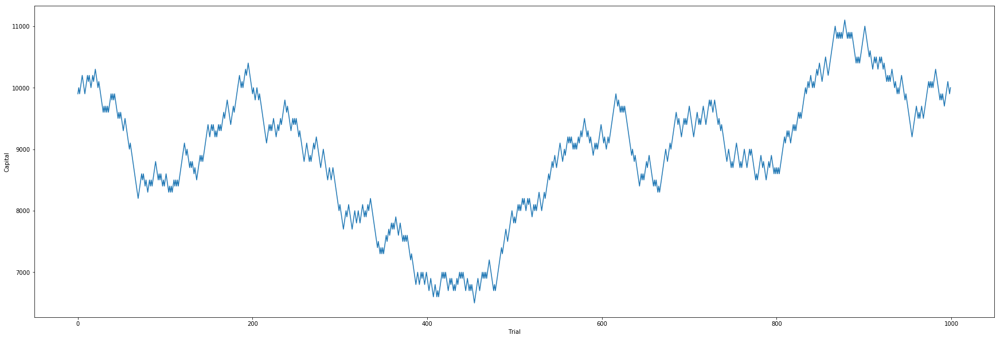

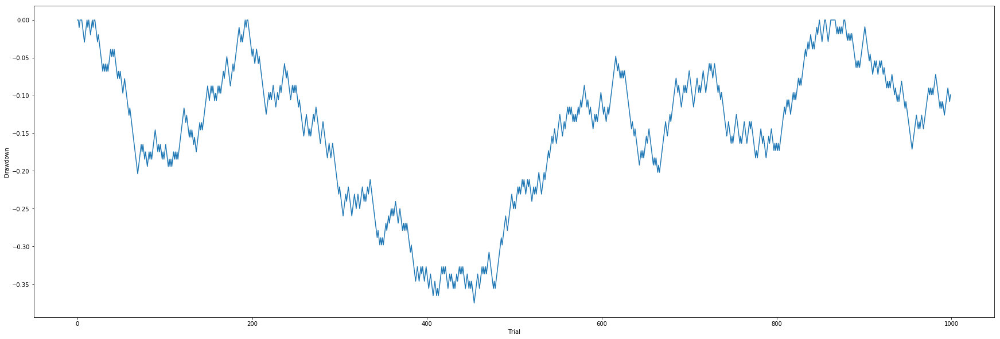

In [21]:
fixed_strategy(init_capital, 100, trials)
plt.show()

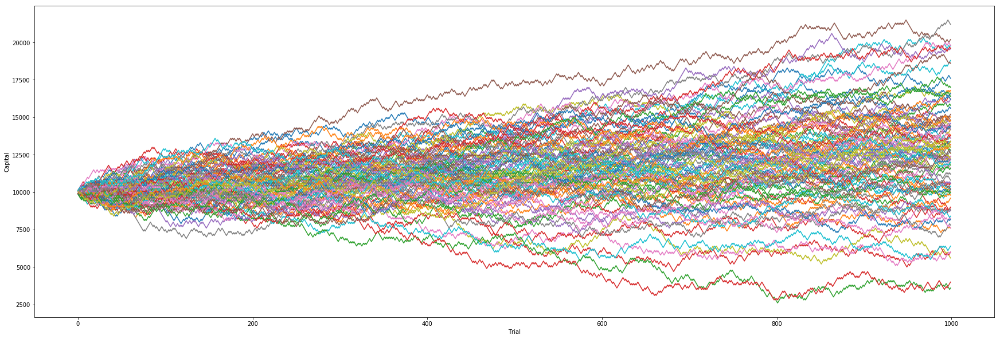

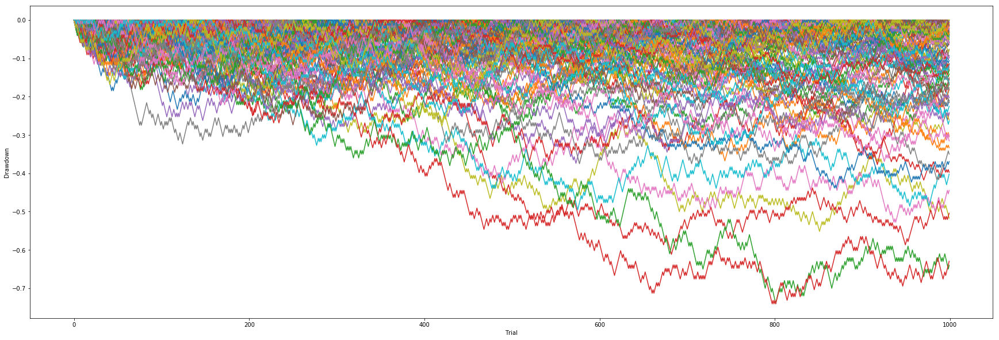

In [22]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = fixed_strategy(init_capital, 100, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [23]:
fixed_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(fixed_results)

fixed_results['cump_balance'] = percent_unit
fixed_results['cump_dd'] = percent_unit

fixed_results['cump_balance'] = fixed_results.sort_values('balance').cump_balance.cumsum()
fixed_results['cump_dd'] = fixed_results.sort_values('drawdown').cump_dd.cumsum()

In [24]:
fixed_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,12716.000000,-0.239334,0.505000,0.505000
std,3569.362334,0.126540,0.290115,0.290115
min,3600.000000,-0.740741,0.010000,0.010000
25%,10200.000000,-0.274385,0.257500,0.257500
50%,12900.000000,-0.208712,0.505000,0.505000
75%,14650.000000,-0.154659,0.752500,0.752500
max,21200.000000,-0.075630,1.000000,1.000000


In [25]:
balance_results = fixed_results.sort_values('balance')
drawdown_results = fixed_results.sort_values('drawdown')

### CDF Ending Balance

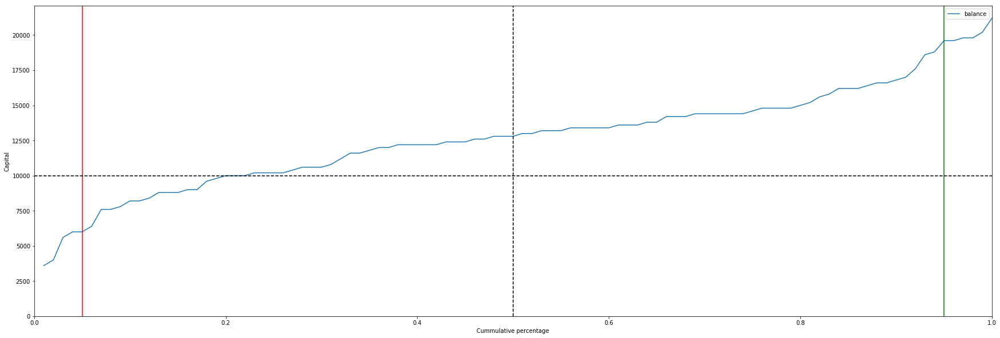

In [26]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [27]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [28]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [29]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 30.00% or less.

There's a 5% chance that return ends at -40.00% or less.

There's a 95% chance that return ends at 96.00% or less.

20.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

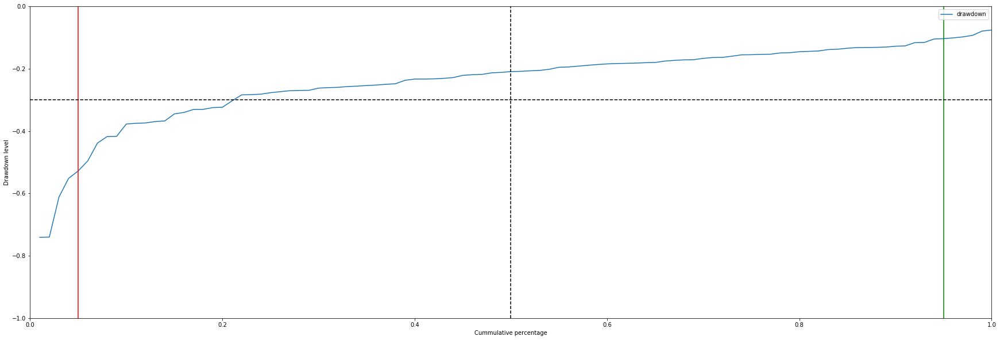

In [30]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [31]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [32]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -20.83% or greater.

There's a 5% chance for MDD to be -52.78% or greater.

There's a 95% chance for MDD to be -10.34% or greater.

21.00% of simulations had greater MDD than -30.00%.


## Fixed percent position sizing

In each roll the player bets a fixed percentage of his current funds, in this case 2% is analyzed.

In [33]:
def percent_strategy(funds, pos_percentage, trials):
    current_funds = funds
    
    trades = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            current_size = current_funds * pos_percentage

            if successful_trade():
                current_funds += current_size
            else:
                current_funds -= current_size

        trades = np.append(trades, single_trade)
        
        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)
        
        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
            
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    
    return (current_funds, min(drawdown))

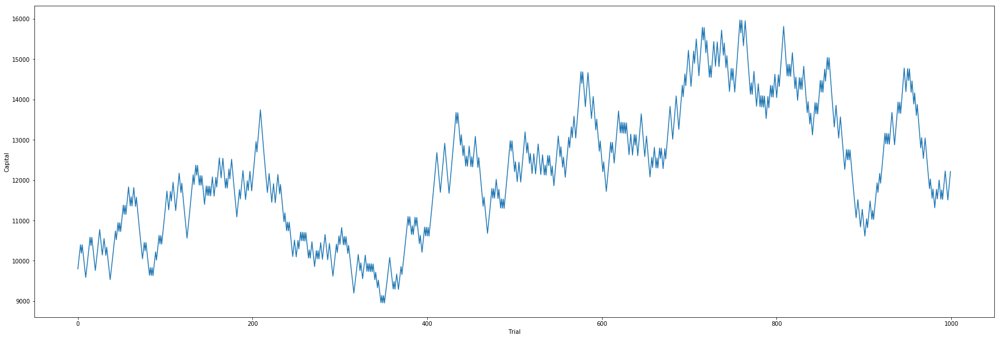

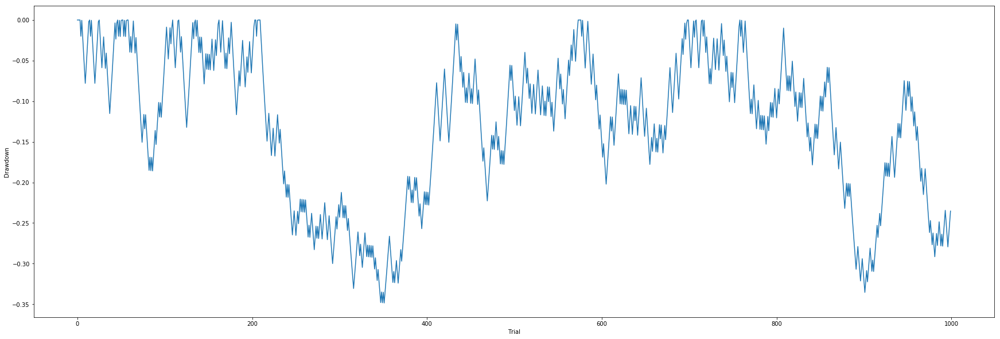

In [34]:
percent_strategy(init_capital, 0.02, trials)
plt.show()

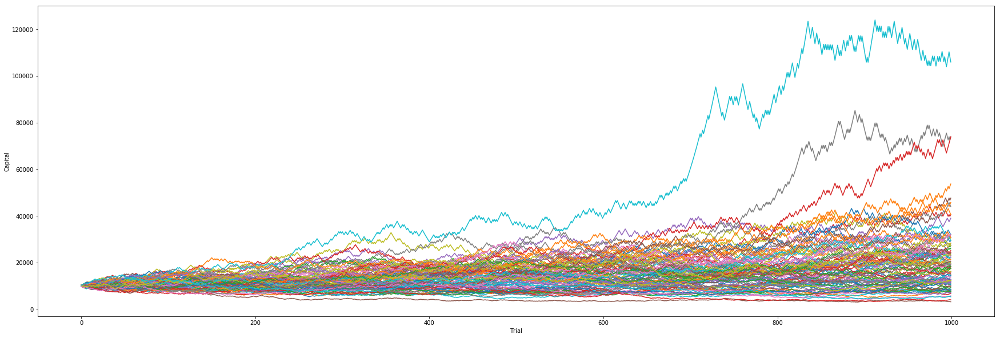

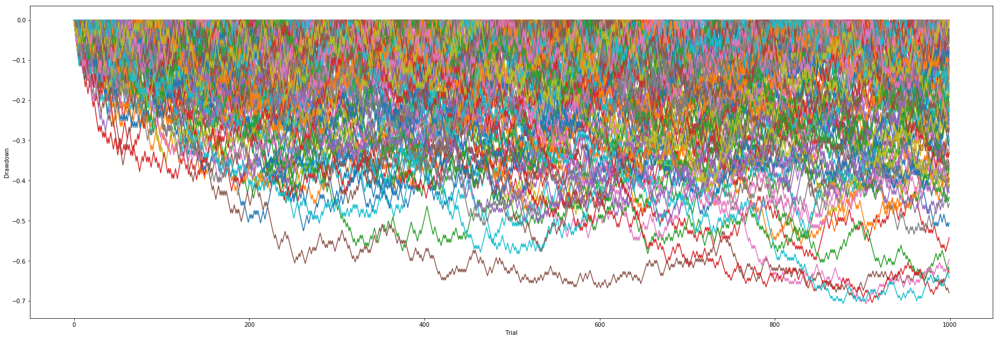

In [35]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = percent_strategy(10000, 0.02, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)
    
plt.show()

In [36]:
percent_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(percent_results)

percent_results['cump_balance'] = percent_unit
percent_results['cump_dd'] = percent_unit

percent_results['cump_balance'] = percent_results.sort_values('balance').cump_balance.cumsum()
percent_results['cump_dd'] = percent_results.sort_values('drawdown').cump_dd.cumsum()

In [37]:
percent_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,21265.303280,-0.421552,0.505000,0.505000
std,15379.074703,0.111168,0.290115,0.290115
min,3134.335067,-0.707465,0.010000,0.010000
25%,11735.202601,-0.486674,0.257500,0.257500
50%,18222.403062,-0.419329,0.505000,0.505000
75%,26386.490550,-0.329482,0.752500,0.752500
max,105941.440951,-0.230209,1.000000,1.000000


In [38]:
balance_results = percent_results.sort_values('balance')
drawdown_results = percent_results.sort_values('drawdown')

### CDF Ending balance

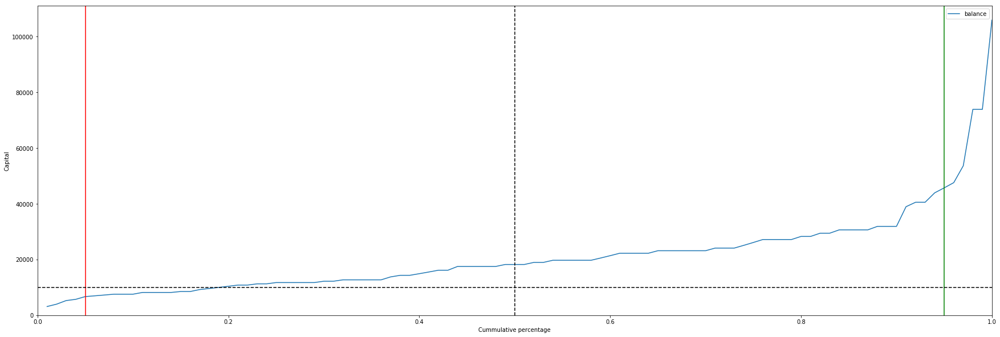

In [39]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [40]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [41]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [42]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 82.22% or less.

There's a 5% chance that return ends at -32.97% or less.

There's a 95% chance that return ends at 357.31% or less.

20.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

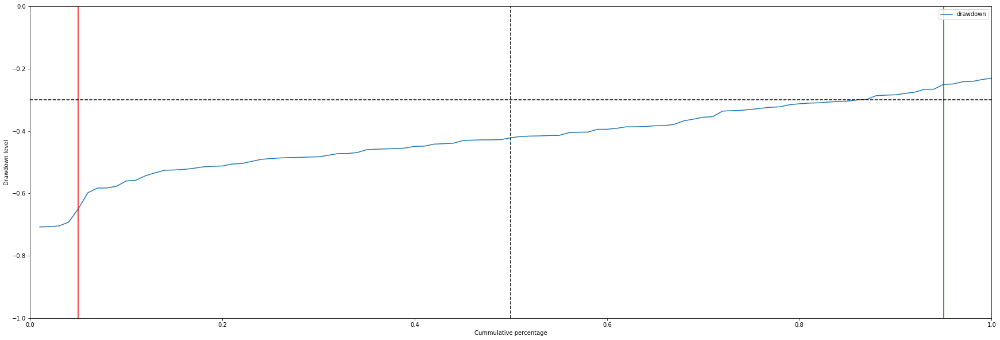

In [43]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [44]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [45]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -41.74% or greater.

There's a 5% chance for MDD to be -64.98% or greater.

There's a 95% chance for MDD to be -25.00% or greater.

85.00% of simulations had greater MDD than -30.00%.


## Martingale position sizing

In the martingale strategy the bet size is doubled after each loss, after a win occurs the bet size returns to the initial betting size.

In [46]:
def martingale_strategy(funds, pos_size, trials):
    current_funds = funds
    current_size = pos_size
    
    trades = np.array([], dtype=int)
    funds = np.array([], dtype=int)
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            if successful_trade():
                current_funds += current_size
                current_size = pos_size
            else:
                current_funds -= current_size
                current_size *= 2
                
        trades = np.append(trades, single_trade)

        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)

        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
                
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    
    return (current_funds, min(drawdown))

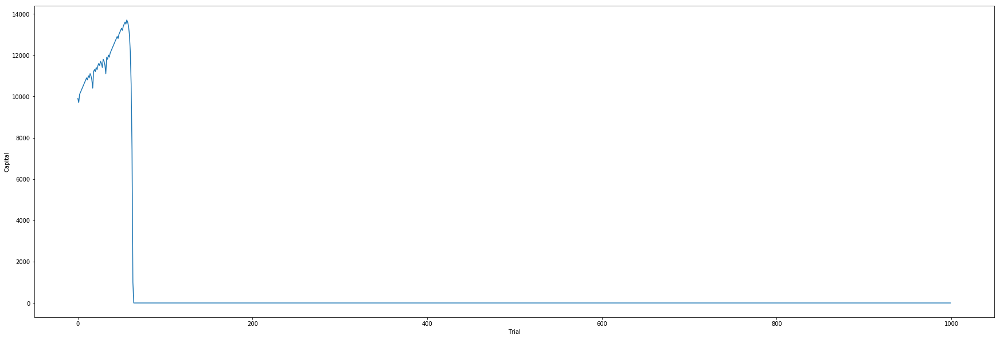

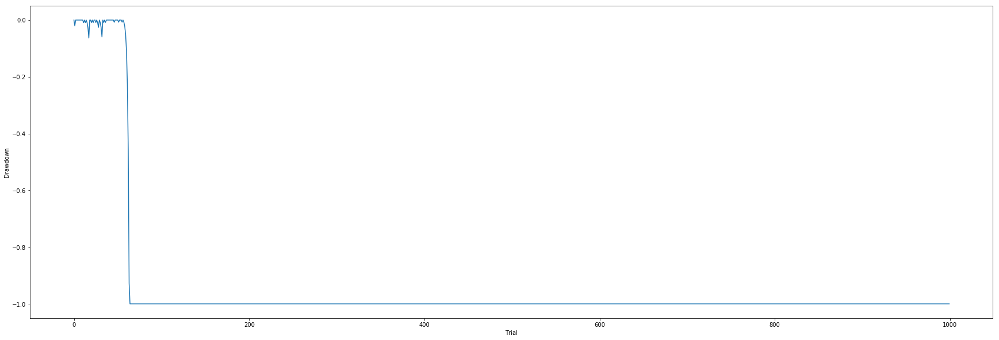

In [47]:
# Single outcome using martingale
martingale_strategy(init_capital, 100, trials)
plt.show()

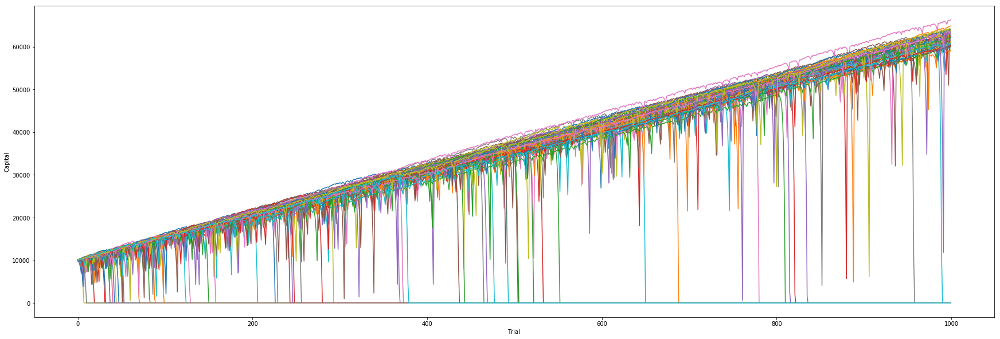

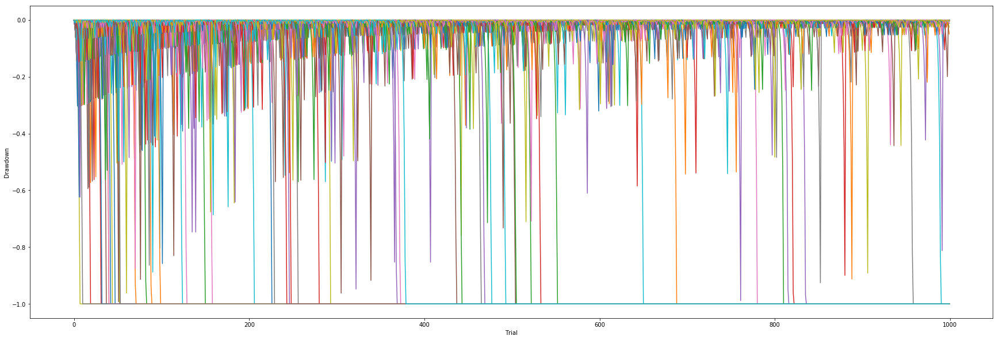

In [48]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = martingale_strategy(init_capital, 100, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [49]:
martingale_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(martingale_results)

martingale_results['cump_balance'] = percent_unit
martingale_results['cump_dd'] = percent_unit

martingale_results['cump_balance'] = martingale_results.sort_values('balance').cump_balance.cumsum()
martingale_results['cump_dd'] = martingale_results.sort_values('drawdown').cump_dd.cumsum()

In [50]:
martingale_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,28531.000000,-0.814078,0.505000,0.505000
std,31086.538368,0.261222,0.290115,0.290115
min,0.000000,-1.000000,0.010000,0.010000
25%,0.000000,-1.000000,0.257500,0.257500
50%,0.000000,-1.000000,0.505000,0.505000
75%,61700.000000,-0.588937,0.752500,0.752500
max,66300.000000,-0.170330,1.000000,1.000000


In [51]:
balance_results = martingale_results.sort_values('balance')
drawdown_results = martingale_results.sort_values('drawdown')

### CDF Ending Balance

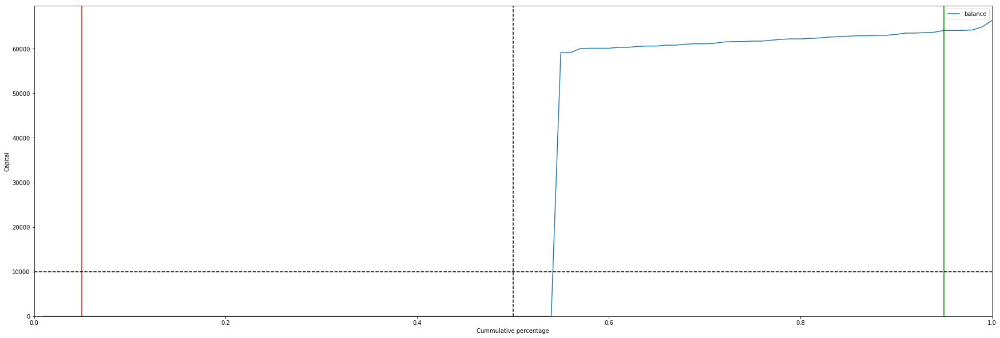

In [52]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [53]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [54]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [55]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at -100.00% or less.

There's a 5% chance that return ends at -100.00% or less.

There's a 95% chance that return ends at 541.00% or less.

55.00% of simulations had capital lost.
54.00% of simulations lost everything.


### CDF Maximum Drawdown

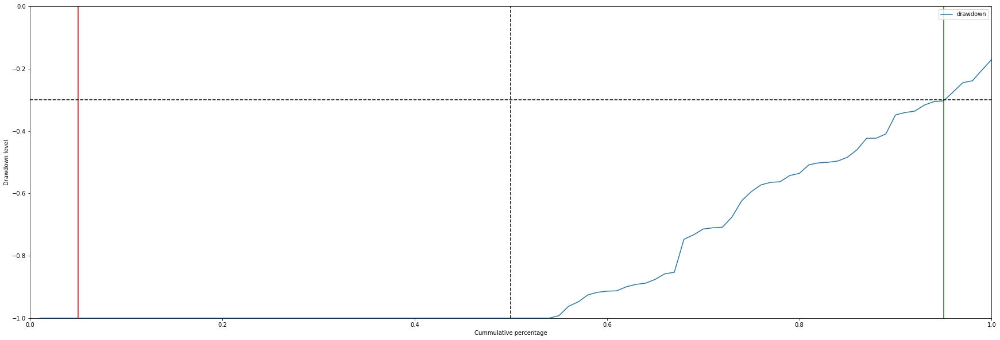

In [56]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [57]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [58]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -100.00% or greater.

There's a 5% chance for MDD to be -100.00% or greater.

There's a 95% chance for MDD to be -30.30% or greater.

95.00% of simulations had greater MDD than -30.00%.


## Progressive position sizing

In this betting method the bet size is increased by 1/3 each time after our earnings are more than 3 times our current bet, when the player looses the bet size is set to the initial bet size.

In [60]:
def progressive_strategy(initial_funds, pos_size, trials):
    current_funds = initial_funds
    current_size = pos_size
    
    trades = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            if successful_trade():
                current_funds += current_size
                earnings = initial_funds - current_funds

                if earnings > (3 * current_size):
                    current_size += (pos_size / 3)
                else:
                    current_size = pos_size
            else:
                current_funds -= current_size
                current_size = pos_size
            
        trades = np.append(trades, single_trade)

        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)
        
        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
    
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    
    return (current_funds, min(drawdown))

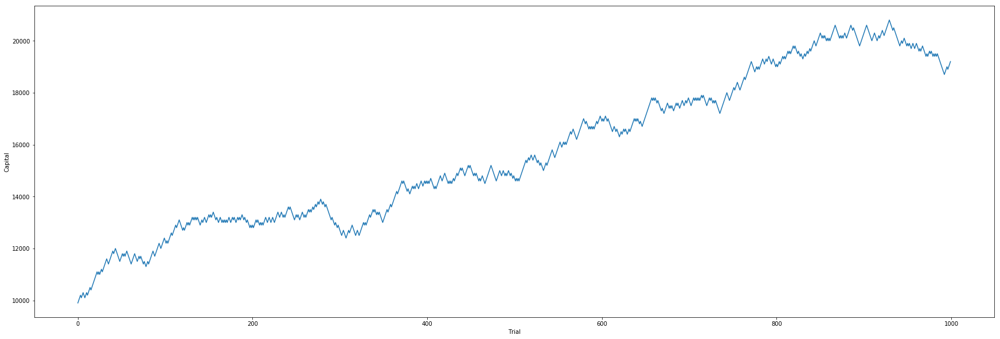

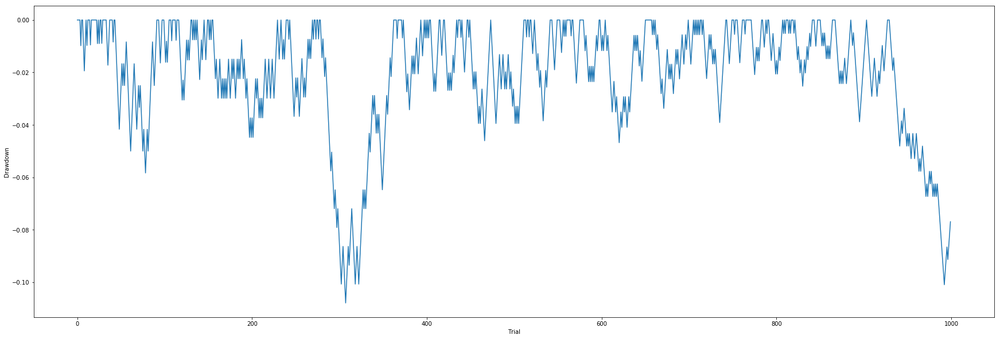

In [61]:
# Bet a 3rd of earnings on winning streaks
progressive_strategy(init_capital, 100, trials)
plt.show()

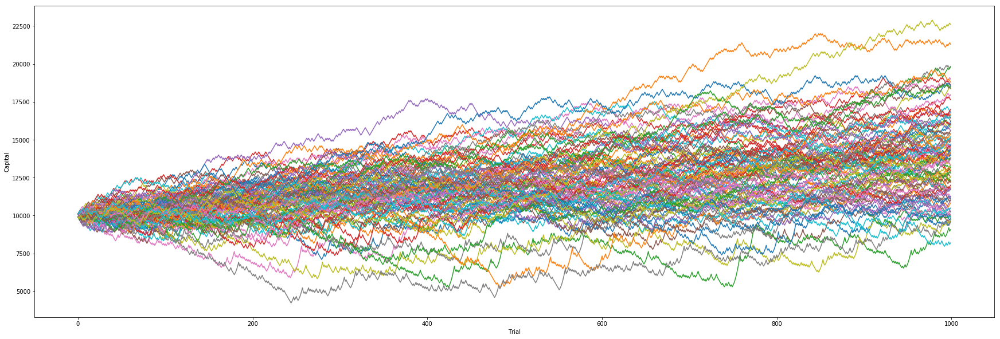

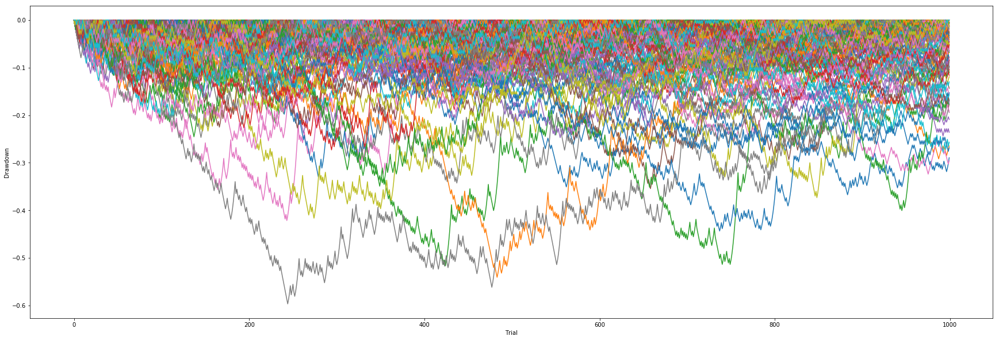

In [62]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = progressive_strategy(init_capital, 100, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [63]:
progressive_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(progressive_results)

progressive_results['cump_balance'] = percent_unit
progressive_results['cump_dd'] = percent_unit

progressive_results['cump_balance'] = progressive_results.sort_values('balance').cump_balance.cumsum()
progressive_results['cump_dd'] = progressive_results.sort_values('drawdown').cump_dd.cumsum()

In [64]:
progressive_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,13885.333333,-0.213300,0.505000,0.505000
std,2953.034240,0.098090,0.290115,0.290115
min,8200.000000,-0.596825,0.010000,0.010000
25%,11791.666667,-0.254197,0.257500,0.257500
50%,13883.333333,-0.189345,0.505000,0.505000
75%,15650.000000,-0.145392,0.752500,0.752500
max,22600.000000,-0.088608,1.000000,1.000000


In [65]:
balance_results = progressive_results.sort_values('balance')
drawdown_results = progressive_results.sort_values('drawdown')

### CDF Ending Balance

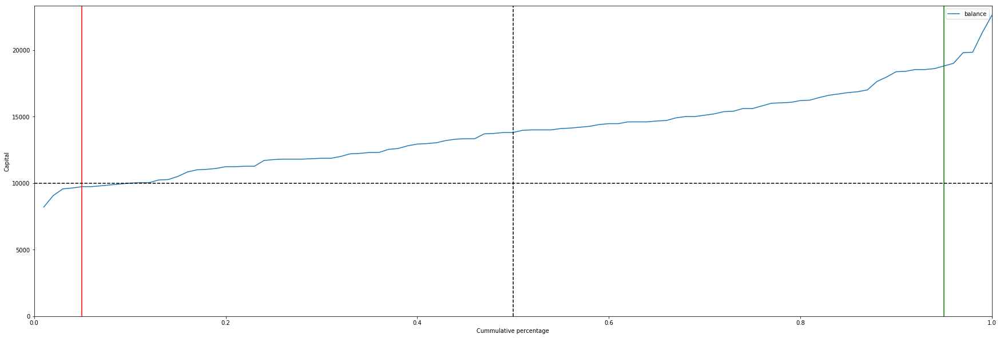

In [66]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [67]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [68]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [69]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 39.67% or less.

There's a 5% chance that return ends at -2.67% or less.

There's a 95% chance that return ends at 88.00% or less.

10.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

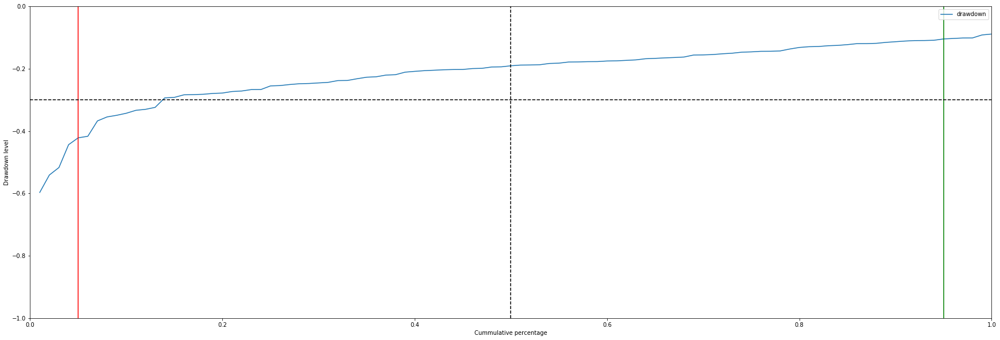

In [70]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [71]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [72]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -18.82% or greater.

There's a 5% chance for MDD to be -42.16% or greater.

There's a 95% chance for MDD to be -10.43% or greater.

13.00% of simulations had greater MDD than -30.00%.


## Kelly Formula

Each time the player bets a percentage based in the probability of winning, is expressed as `f = p - q` where:

- `f = funds percentage to bet`
- `p = P(Wining)`
- `q = 1 - p`

### Static

The probability of winning never changes

In [73]:
def kelly_strategy(funds, trials):
    current_funds = funds
    q = 1 - p_winning
    
    trades = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            current_size = current_funds * (p_winning - q)

            if successful_trade():
                current_funds += current_size
            else:
                current_funds -= current_size

        trades = np.append(trades, single_trade)
        
        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)

        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
        
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    
    return (current_funds, min(drawdown))

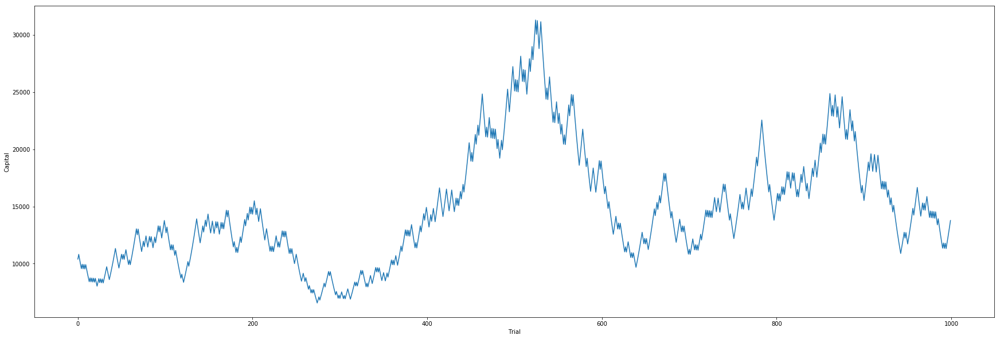

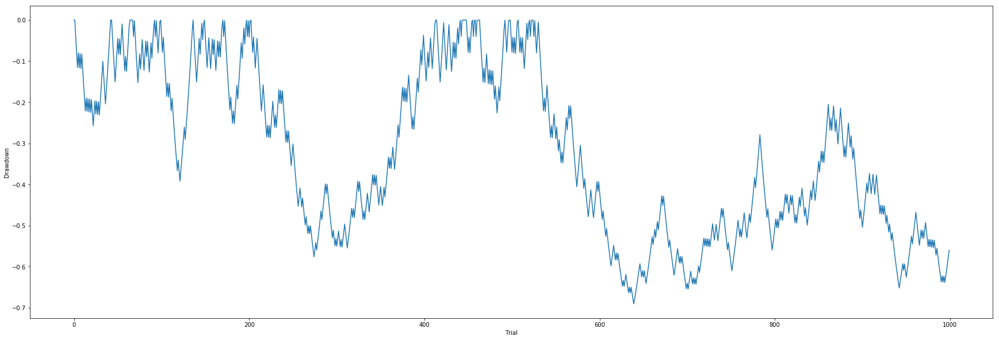

In [75]:
kelly_strategy(init_capital, trials)
plt.show()

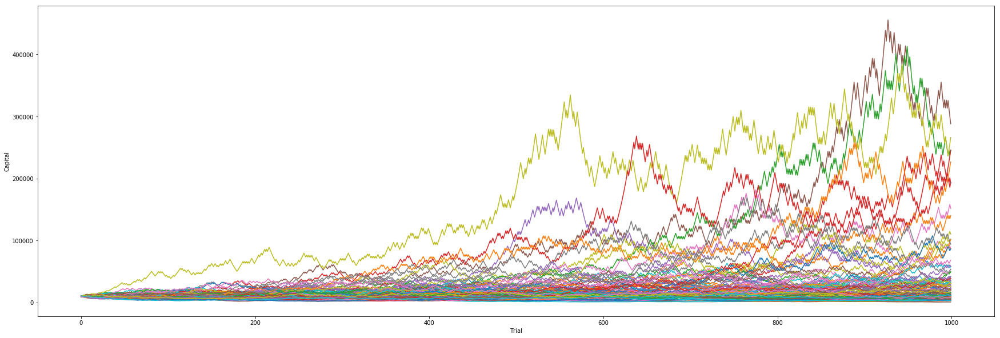

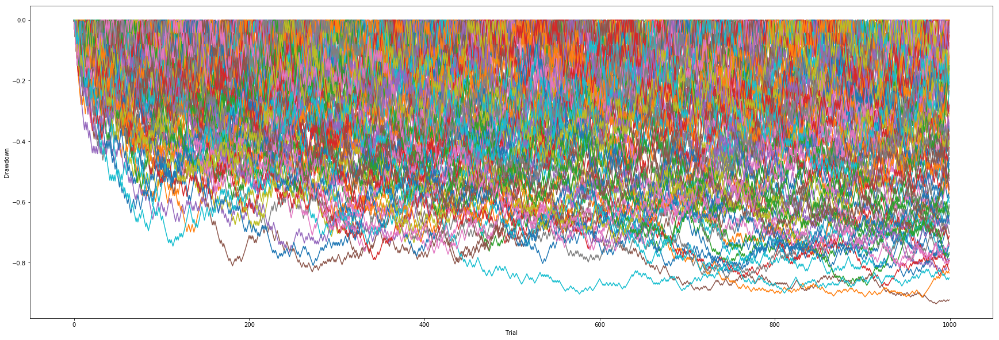

In [76]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = kelly_strategy(init_capital, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)
    
plt.show()

In [77]:
kelly_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(kelly_results)

kelly_results['cump_balance'] = percent_unit
kelly_results['cump_dd'] = percent_unit

kelly_results['cump_balance'] = kelly_results.sort_values('balance').cump_balance.cumsum()
kelly_results['cump_dd'] = kelly_results.sort_values('drawdown').cump_dd.cumsum()

In [78]:
kelly_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,44826.848133,-0.680794,0.505000,0.505000
std,61569.593001,0.123053,0.290115,0.290115
min,905.824460,-0.936305,0.010000,0.010000
25%,9805.597542,-0.776202,0.257500,0.257500
50%,21404.000629,-0.687228,0.505000,0.505000
75%,44063.311534,-0.571948,0.752500,0.752500
max,288347.170859,-0.393654,1.000000,1.000000


In [79]:
balance_results = kelly_results.sort_values('balance')
drawdown_results = kelly_results.sort_values('drawdown')

### CDF Ending Balance

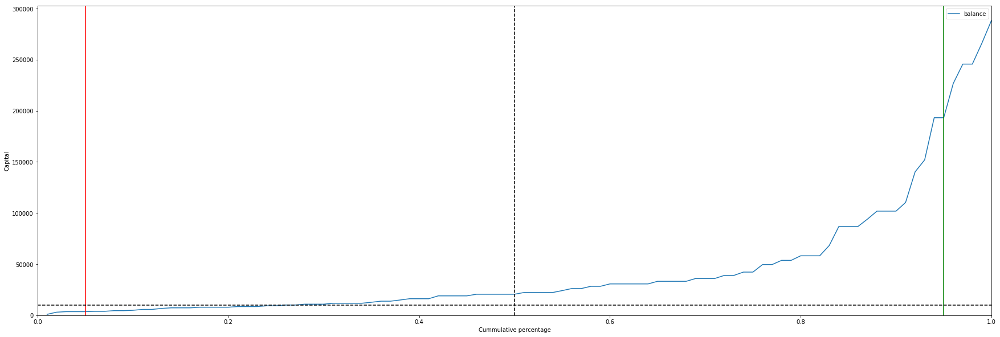

In [80]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [81]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [82]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [83]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 122.60% or less.

There's a 5% chance that return ends at -64.68% or less.

There's a 95% chance that return ends at 1832.44% or less.

28.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

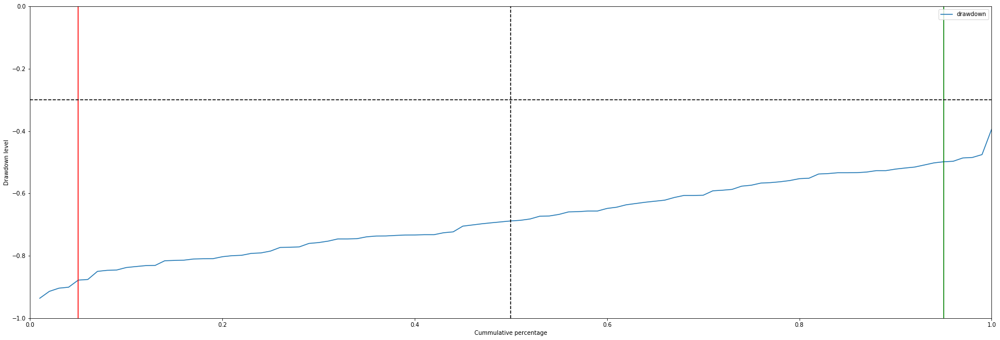

In [84]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [85]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [86]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -68.62% or greater.

There's a 5% chance for MDD to be -87.82% or greater.

There's a 95% chance for MDD to be -49.84% or greater.

100.00% of simulations had greater MDD than -30.00%.


### Dynamic

The probability of winning varies between X and Y.

In [87]:
def kelly_strategy_dynamic(initial_funds, trials):
    current_funds = initial_funds
    
    trades = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            chance_winning = np.random.normal(52, 4)  # With mean = 55, std = 5, 94% of the times the player wins 
            chance_loosing = 100 - chance_winning

            percent_size = abs(chance_winning - chance_loosing) / 100
            current_size = math.floor(current_funds * percent_size)

            if successful_trade(p=(chance_winning / 100)):
                current_funds += current_size
            else:
                current_funds -= current_size

        trades = np.append(trades, single_trade)

        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)

        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
            
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    
    return (current_funds, min(drawdown))

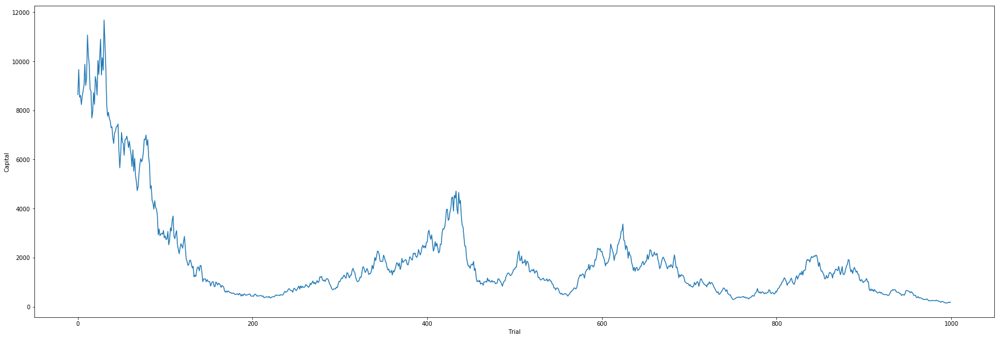

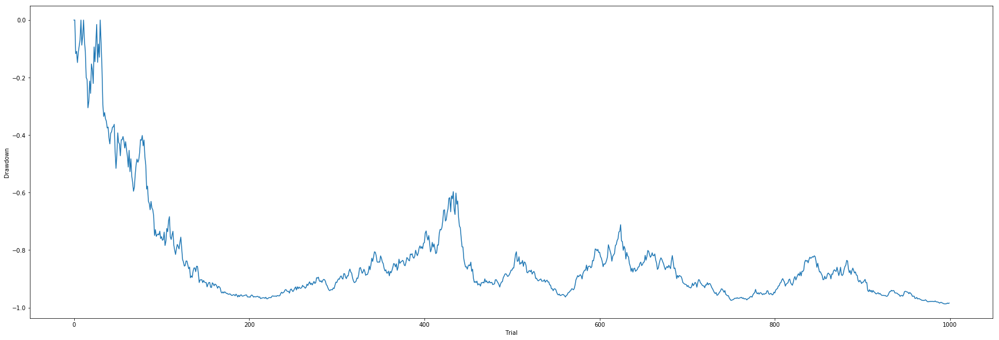

In [89]:
kelly_strategy_dynamic(init_capital, trials)
plt.show()

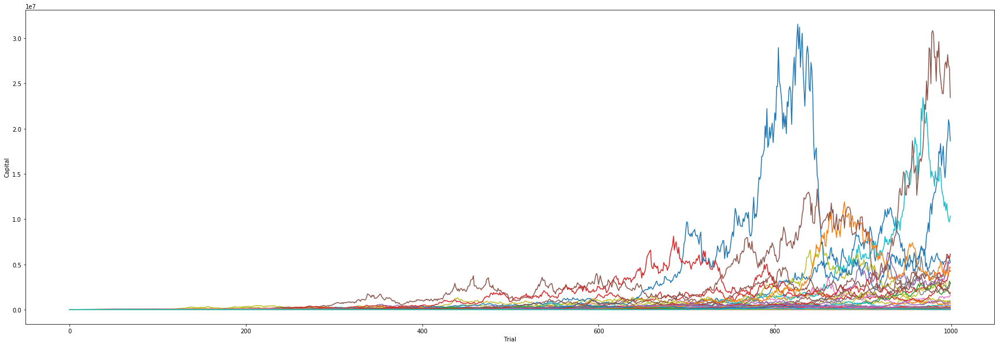

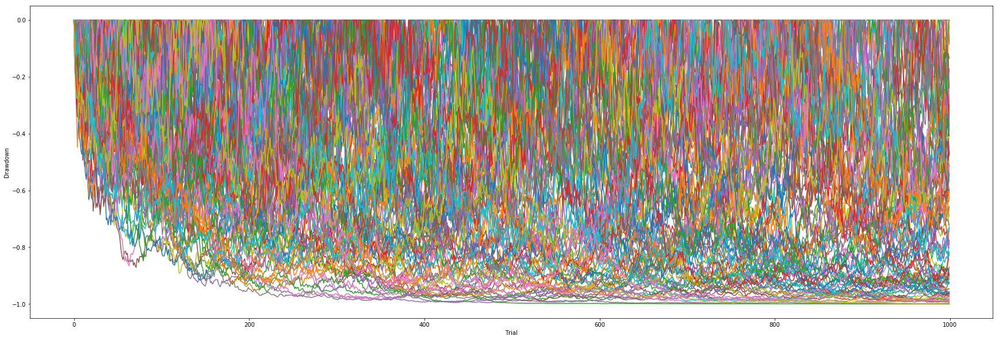

In [90]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = kelly_strategy_dynamic(init_capital, trials)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [91]:
kellyd_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(kellyd_results)

kellyd_results['cump_balance'] = percent_unit
kellyd_results['cump_dd'] = percent_unit

kellyd_results['cump_balance'] = kellyd_results.sort_values('balance').cump_balance.cumsum()
kellyd_results['cump_dd'] = kellyd_results.sort_values('drawdown').cump_dd.cumsum()

In [92]:
kellyd_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,1.000000e+02,100.000000,100.000000,100.000000
mean,1.047168e+06,-0.920455,0.505000,0.505000
std,3.327327e+06,0.076516,0.290115,0.290115
min,4.000000e+00,-0.999704,0.010000,0.010000
25%,4.258750e+03,-0.974900,0.257500,0.257500
50%,2.476600e+04,-0.942301,0.505000,0.505000
75%,2.131675e+05,-0.884071,0.752500,0.752500
max,2.343707e+07,-0.623135,1.000000,1.000000


In [93]:
balance_results = kellyd_results.sort_values('balance')
drawdown_results = kellyd_results.sort_values('drawdown')

### CDF Ending Balance

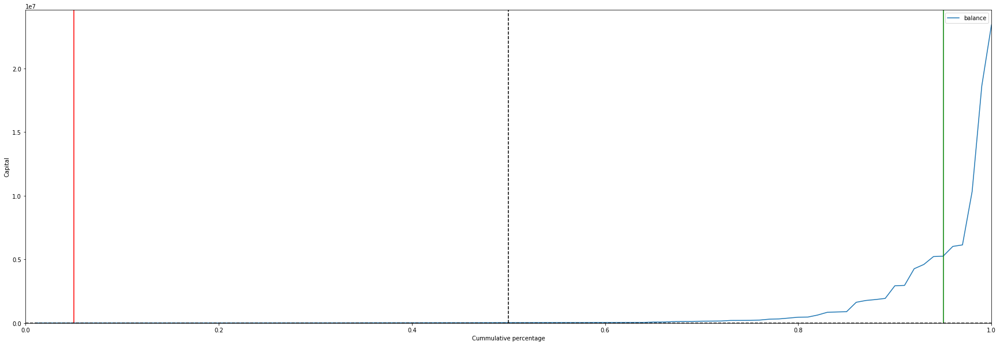

In [94]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [95]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [96]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [97]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 152.48% or less.

There's a 5% chance that return ends at -97.69% or less.

There's a 95% chance that return ends at 52441.59% or less.

36.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

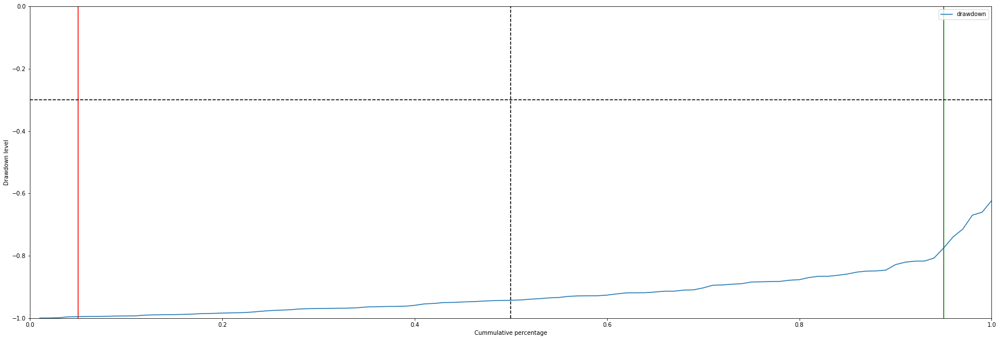

In [98]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [99]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [100]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -94.19% or greater.

There's a 5% chance for MDD to be -99.55% or greater.

There's a 95% chance for MDD to be -77.54% or greater.

100.00% of simulations had greater MDD than -30.00%.


## D'Alembert position sizing

Each time the player looses the bet is increased by some fixed amount, when the player wins the bet size is reduced by the same amount.

In [102]:
def dalembert_strategy(initial_funds, pos_size, trials, increase_on_win=False, increase_by=1):
    current_funds = initial_funds
    current_size = pos_size
    
    delta = pos_size * increase_by
    
    trades = np.array([])
    funds = np.array([])
    drawdown = np.array([], dtype=float)
    
    for single_trade in range(trials):
        if current_funds > 0:
            if successful_trade():
                current_funds += current_size

                if increase_on_win:
                    current_size += delta
                else:
                    current_size -= delta
            else:
                current_funds -= current_size

                if increase_on_win:
                    current_size -= delta
                else:
                    current_size += delta

        trades = np.append(trades, single_trade)
        
        # Funds to samples
        if current_funds < 0:
            current_funds = 0

        funds = np.append(funds, current_funds)
        
        # Drawdown to samples
        if current_funds > 0:
            dd = (current_funds - np.amax(funds)) / np.amax(funds)
        else:
            dd = -1

        drawdown = np.append(drawdown, np.amin([0, dd]))
            
    plt.figure(0)
    plt.plot(trades, funds)
    plt.xlabel('Trial')
    plt.ylabel('Capital')
    
    plt.figure(1)
    plt.plot(trades, drawdown)
    plt.xlabel('Trial')
    plt.ylabel('Drawdown')
    
    return (current_funds, min(drawdown))

### Increase or decrease by 10% of the initial bet amount

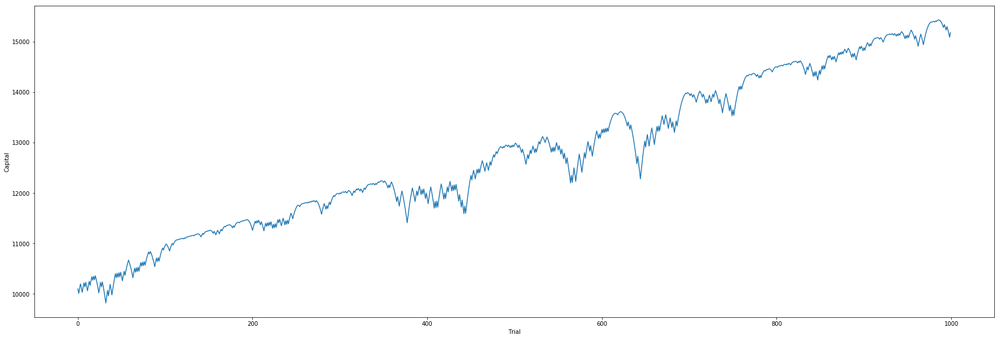

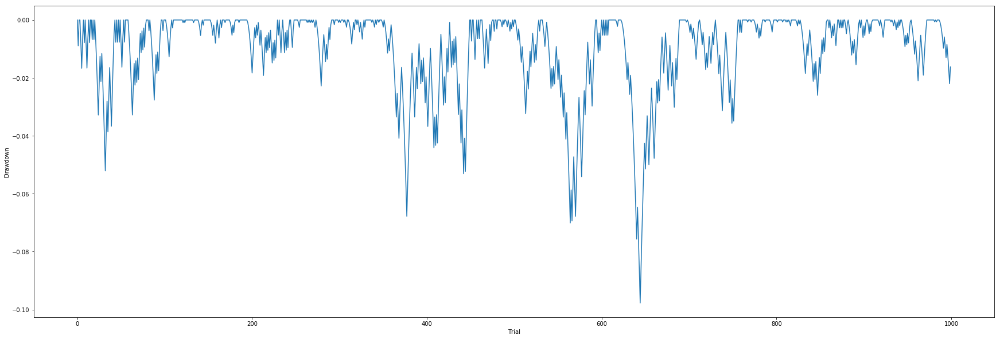

In [103]:
dalembert_strategy(init_capital, 100, trials, increase_by=.10)
plt.show()

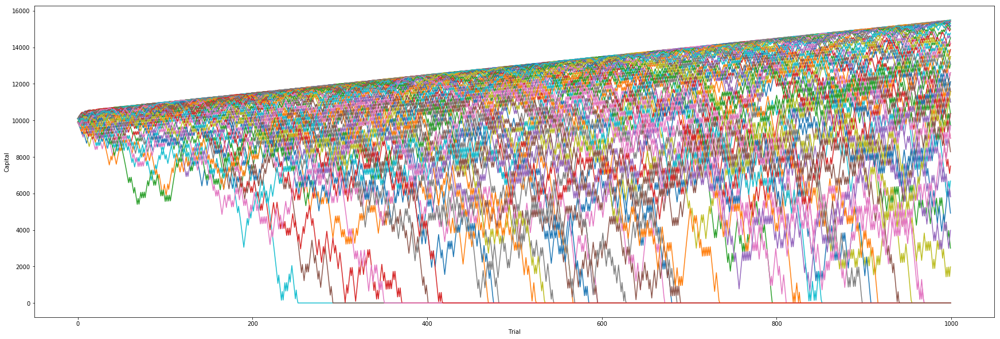

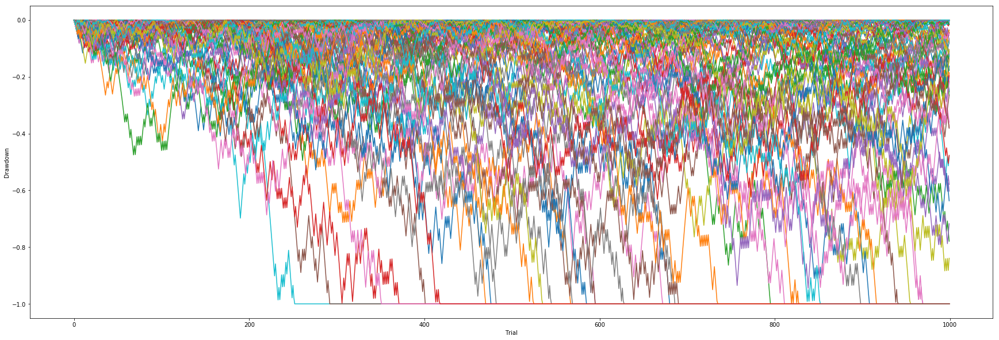

In [104]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = dalembert_strategy(init_capital, 100, trials, increase_by=.10)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [105]:
dalembert_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(dalembert_results)

dalembert_results['cump_balance'] = percent_unit
dalembert_results['cump_dd'] = percent_unit

dalembert_results['cump_balance'] = dalembert_results.sort_values('balance').cump_balance.cumsum()
dalembert_results['cump_dd'] = dalembert_results.sort_values('drawdown').cump_dd.cumsum()

In [106]:
dalembert_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,8051.600000,-0.619166,0.505000,0.505000
std,6445.914957,0.334423,0.290115,0.290115
min,0.000000,-1.000000,0.010000,0.010000
25%,0.000000,-1.000000,0.257500,0.257500
50%,10380.000000,-0.600475,0.505000,0.505000
75%,14220.000000,-0.331991,0.752500,0.752500
max,15500.000000,-0.053364,1.000000,1.000000


In [107]:
balance_results = dalembert_results.sort_values('balance')
drawdown_results = dalembert_results.sort_values('drawdown')

### CDF Ending Balance

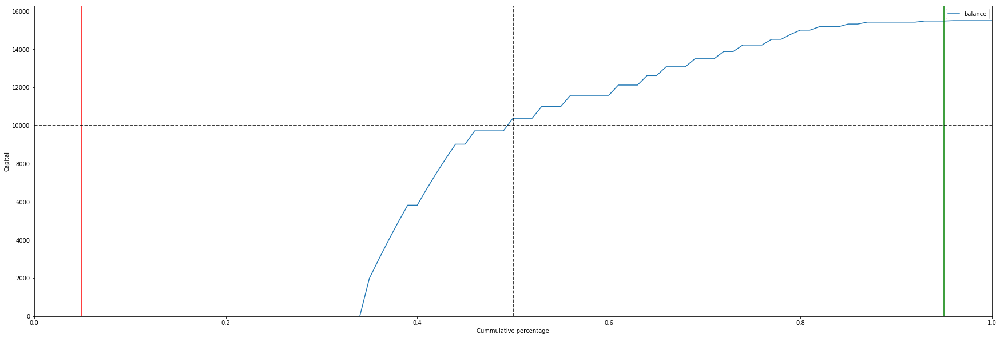

In [108]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [109]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [110]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [111]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 3.80% or less.

There's a 5% chance that return ends at -100.00% or less.

There's a 95% chance that return ends at 54.80% or less.

50.00% of simulations had capital lost.
34.00% of simulations lost everything.


### CDF Maximum Drawdown

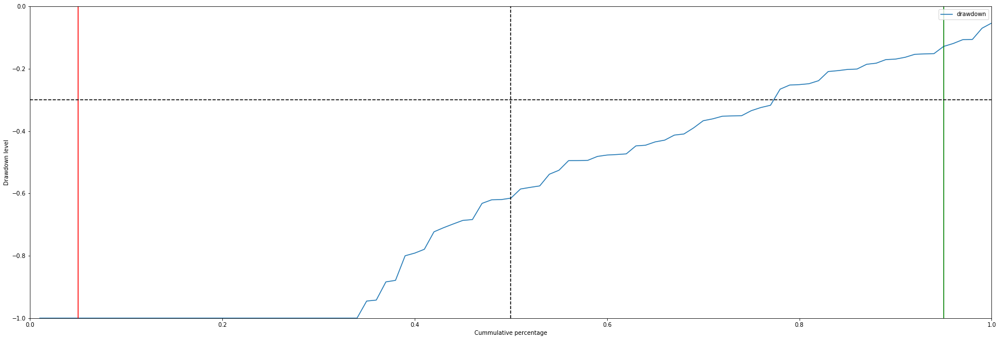

In [112]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [113]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [114]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -58.58% or greater.

There's a 5% chance for MDD to be -100.00% or greater.

There's a 95% chance for MDD to be -12.84% or greater.

77.00% of simulations had greater MDD than -30.00%.


### Inverse D'Alembert

Now when loosing we decrease by 10% of the initial bet size, and when winning we increase by that same amount.

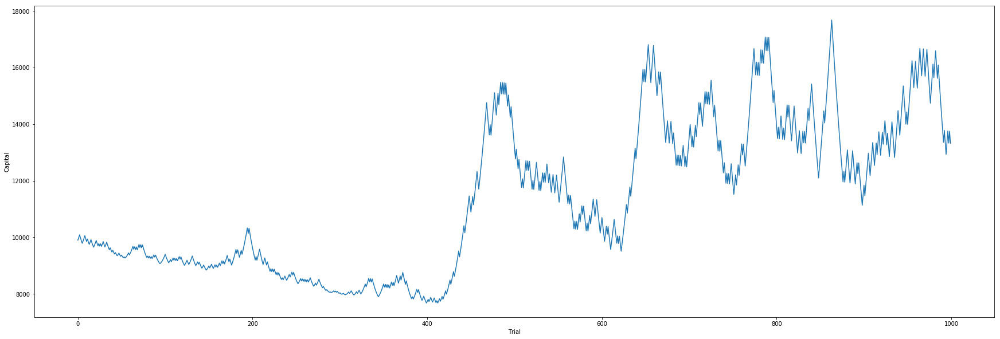

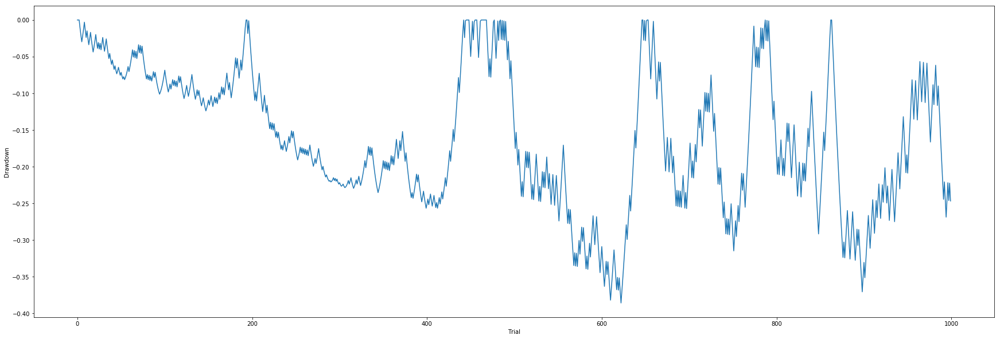

In [115]:
dalembert_strategy(init_capital, 100, trials, increase_by=.10, increase_on_win=True)
plt.show()

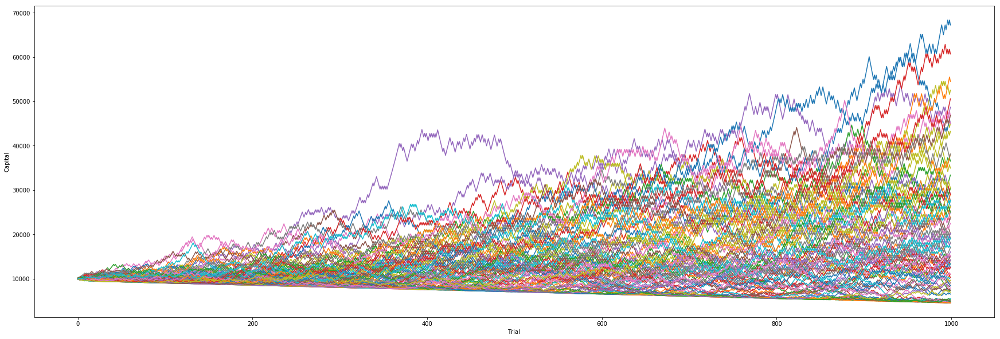

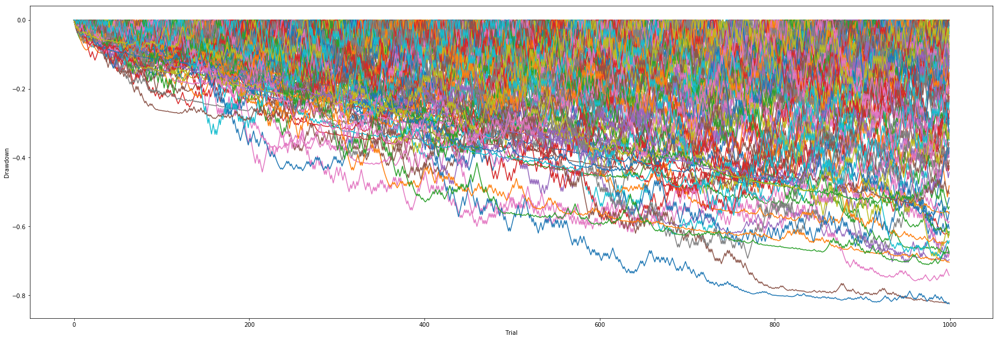

In [116]:
balances = np.array([], dtype=int)
drawdowns = np.array([], dtype=float)

for _ in range(run_times):
    run_result, run_dd = dalembert_strategy(init_capital, 100, trials, increase_by=.10, increase_on_win=True)
    balances = np.append(balances, run_result)
    drawdowns = np.append(drawdowns, run_dd)

plt.show()

In [117]:
dalembertip_results = pd.DataFrame({'balance': balances, 'drawdown': drawdowns})
percent_unit = 1 / len(dalembertip_results)

dalembertip_results['cump_balance'] = percent_unit
dalembertip_results['cump_dd'] = percent_unit

dalembertip_results['cump_balance'] = dalembertip_results.sort_values('balance').cump_balance.cumsum()
dalembertip_results['cump_dd'] = dalembertip_results.sort_values('drawdown').cump_dd.cumsum()

In [118]:
dalembertip_results.describe()

,balance,drawdown,cump_balance,cump_dd
count,100.000000,100.000000,100.000000,100.000000
mean,20742.200000,-0.476329,0.505000,0.505000
std,14511.996262,0.137104,0.290115,0.290115
min,4500.000000,-0.825109,0.010000,0.010000
25%,8855.000000,-0.564533,0.257500,0.257500
50%,17510.000000,-0.457664,0.505000,0.505000
75%,27620.000000,-0.384169,0.752500,0.752500
max,67220.000000,-0.228509,1.000000,1.000000


In [119]:
balance_results = dalembertip_results.sort_values('balance')
drawdown_results = dalembertip_results.sort_values('drawdown')

### CDF Ending Balance

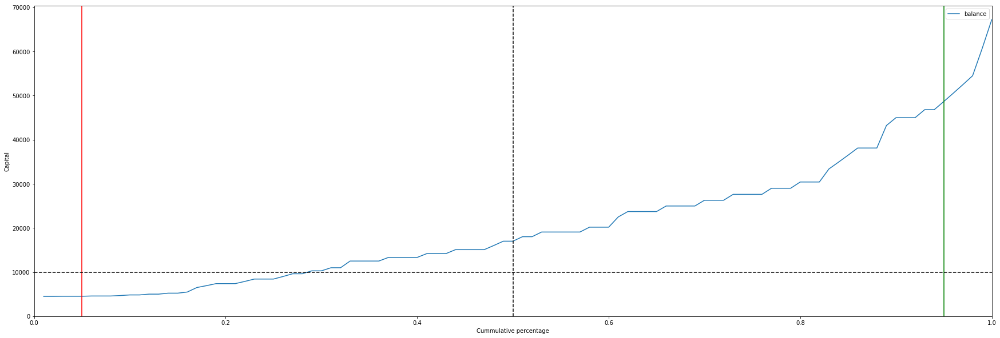

In [120]:
ax = balance_results.plot(x='cump_balance', y='balance')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(init_capital, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Capital')
plt.xlim(0, 1)
plt.ylim(bottom=0)
plt.show()

In [121]:
percentile_5th = balance_results[balance_results.cump_balance <= percentile_below].tail(1)
percentile_95th = balance_results[balance_results.cump_balance >= percentile_above].head(1)
percentile_50th = balance_results.iloc[int(len(balance_results) / 2)]

threshold = balance_results[balance_results.balance >= init_capital].head(1)
ruin_threshold = balance_results[balance_results.balance <= ruin_capital].tail(1)

In [122]:
p5th_delta = (percentile_5th.balance.values[0] - init_capital) / init_capital
p95th_delta = (percentile_95th.balance.values[0] - init_capital) / init_capital
p50th_delta = (percentile_50th.balance - init_capital) / init_capital

In [123]:
print('On average return is expected to end at {:.2f}% or less.\n'.format(p50th_delta * 100))
print("There's a 5% chance that return ends at {:.2f}% or less.\n".format(p5th_delta * 100))
print("There's a 95% chance that return ends at {:.2f}% or less.\n".format(p95th_delta * 100))

print('{:.2f}% of simulations had capital lost.'.format(threshold.cump_balance.values[0] * 100))

if ruin_threshold.empty:
    print('  None of the simulations lost everything')
else:
    print('{:.2f}% of simulations lost everything.'.format(ruin_threshold.cump_balance.values[0] * 100))

On average return is expected to end at 80.20% or less.

There's a 5% chance that return ends at -54.80% or less.

There's a 95% chance that return ends at 386.80% or less.

29.00% of simulations had capital lost.
  None of the simulations lost everything


### CDF Maximum Drawdown

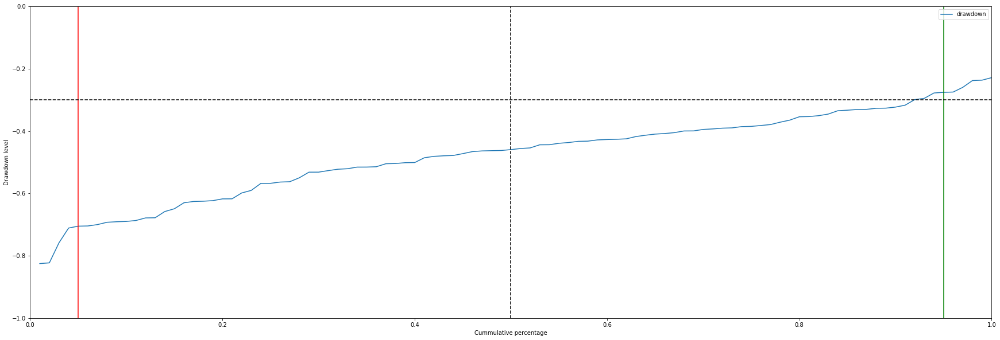

In [124]:
ax = drawdown_results.plot(x='cump_dd', y='drawdown')
ax.axvline(percentile_avg, color='black', linestyle='--')
ax.axvline(percentile_below, color='red')
ax.axvline(percentile_above, color='green')
ax.axhline(mdd_level, color='black', linestyle='--')
plt.xlabel('Cummulative percentage')
plt.ylabel('Drawdown level')
plt.xlim(0, 1)
plt.ylim(-1, 0)
plt.show()

In [125]:
percentile_5th = drawdown_results[drawdown_results.cump_dd <= percentile_below].tail(1)
percentile_95th = drawdown_results[drawdown_results.cump_dd >= percentile_above].head(1)
percentile_50th = drawdown_results.iloc[int(len(drawdown_results) / 2)]

threshold = drawdown_results[drawdown_results.drawdown <= mdd_level].tail(1)

In [126]:
print('On average MDD is expected to be {:.2f}% or greater.\n'.format(percentile_50th.drawdown * 100))
print("There's a 5% chance for MDD to be {:.2f}% or greater.\n".format(percentile_5th.drawdown.values[0] * 100))
print("There's a 95% chance for MDD to be {:.2f}% or greater.\n".format(percentile_95th.drawdown.values[0] * 100))

print('{:.2f}% of simulations had greater MDD than {:.2f}%.'.format(threshold.cump_dd.values[0] * 100, mdd_level * 100))

On average MDD is expected to be -45.59% or greater.

There's a 5% chance for MDD to be -70.50% or greater.

There's a 95% chance for MDD to be -27.56% or greater.

91.00% of simulations had greater MDD than -30.00%.
